In [1]:
import pandas
import pycaret
import numpy as np
import math
import matplotlib.pyplot as plt
#from imblearn.over_sampling import SMOTE
#from sklearn.preprocessing import MinMaxScaler
#import smogn

from pycaret.regression import load_model

In [2]:
filename = "Data_2021_08_17_v1_m.csv"

In [5]:
csv = pandas.read_csv(filename)
csv = csv.dropna(axis=0).reset_index(drop=True)#drop NaN
csv = csv[csv['Lmt']>0.1].reset_index(drop=True)
csv = csv[csv['Lmr']>0.1].reset_index(drop=True)
csv = csv[csv['k']>0].reset_index(drop=True)

array_len = len(csv)

for i in range(0, array_len): 

    csv['I1'][i] = csv['I1'][i].replace('i', 'j')
    csv['I2'][i] = csv['I2'][i].replace('i', 'j')
    csv['I1'][i] = csv['I1'][i].replace(' ', '')
    csv['I2'][i] = csv['I2'][i].replace(' ', '')
    csv['I1'][i] = complex(csv['I1'][i]).real
    csv['I2'][i] = complex(csv['I2'][i]).real

    if csv['Lt'][i] > 100 and csv['Lt'][i]/csv['Lmt'][i] > 0.5:
        csv['Lt'][i] = csv['Lt'][i] * 1e-3
    if csv['Lr'][i] > 100 and csv['Lr'][i]/csv['Lmr'][i] > 0.5:
        csv['Lr'][i] = csv['Lr'][i] * 1e-3
    if csv['Lm'][i] > 100 and csv['Lmt'][i] > 50:
        csv['Lm'][i] = csv['Lm'][i] * 1e-3
    if csv['Lm'][i] > 100:
        csv['Lm'][i] = csv['Lm'][i] * 1e-3

csv['I1'] = pandas.to_numeric(csv['I1'], downcast="float")
csv['I2'] = pandas.to_numeric(csv['I2'], downcast="float")


data = csv.sample(frac=0.9, random_state=786).reset_index(drop=True)
data_unseen = csv.drop(data.index).reset_index(drop=True)


print('Data for Modeling: ' + str(data.shape))
print('Unseen Data For Predictions: ' + str(data_unseen.shape))

csv.to_csv("./test_data.csv")

Data for Modeling: (89438, 37)
Unseen Data For Predictions: (9938, 37)


In [6]:
csv

,N1,N2,d1,d2,freq,move_tx,move_rx,offset_tx,offset_rx,per,space1,space2,space3,space4,space5,space6,l1,l2,h1,w1,Lmt,Lmr,Llt,Llr,k,Lt,Lr,Lm,Rt,Rr,I1,I2,Zt,Zr,Zm,copperloss_tx,copperloss_rx
0,10,16,1.29,1.03,40000.0,1.81,2.35,-3.5,-0.5,2347,5.76,13.97,3.90,19.84,2.86,2.96,10.1,58,29,27,0.828882,2.118629,9.921835,25.360299,0.994068,0.838804,2.143990,1.333084,9.560755,24.478330,0.660000,0.441787,9.560755302 + 210.8143478i,24.4783305 + 538.8433753i,15.22024239 + 335.0406531i,0.009637,0.013485
1,10,16,1.50,1.13,40000.0,3.02,2.51,3.0,3.0,3666,3.01,17.66,2.98,21.12,2.94,2.92,18.6,55,37,86,6.583411,16.844768,21.208488,54.265495,0.998393,6.604619,16.899033,10.547667,76.067834,194.729043,0.249000,0.165429,0.07606783407 + 1.659921917i,0.1947290431 + 4.247190333i,0.1215911863 + 2.650917885i,0.002063,0.002857
2,10,16,0.74,1.74,40000.0,1.23,2.33,13.5,2.0,4392,4.68,27.08,2.29,9.67,4.29,2.68,19.7,44,42,44,4.457473,11.397761,20.579676,52.622245,0.997700,4.478052,11.450383,7.144212,51.623162,131.917851,0.237000,0.162938,0.05162316199 + 1.125457327i,0.131917851 + 2.87779511i,0.08235954697 + 1.795536397i,0.003256,0.002478
3,10,16,1.05,1.66,40000.0,2.97,2.66,-4.0,-7.5,2686,1.84,27.01,2.87,29.94,4.38,3.94,19.2,49,61,69,3.423661,8.763507,27.617682,70.692665,0.995991,3.451279,8.834199,5.499573,39.658451,101.465637,0.156000,0.089700,39.65845099 + 867.4009961i,0.1014656369 + 2.220276427i,0.06332069048 + 1.382193498i,0.000922,0.000658
4,6,8,0.73,1.75,40000.0,1.38,3.24,4.0,6.5,4008,1.50,22.98,2.97,12.29,4.23,3.68,12.4,47,54,28,0.553679,0.983045,5.308163,9.424528,0.995241,0.558987,0.992469,0.741289,6.437033,11.379202,0.497000,0.334730,6.437032833 + 140.4887318i,11.37920209 + 249.4346884i,8.510568521 + 186.3061875i,0.006300,0.001998
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99371,18,10,1.08,1.36,40000.0,1.46,2.62,1.5,-7.0,4921,5.44,14.92,4.96,17.95,3.65,2.70,12.6,52,52,62,13.373615,4.128797,47.798155,14.756585,0.998218,13.421413,4.143554,7.444078,154.511578,47.710604,0.341543,0.701000,0.1545115783 + 3.373169033i,0.04771060388 + 1.041388632i,0.08573682154 + 1.870900772i,0.010929,0.018635
99372,6,8,0.68,1.84,40000.0,1.40,3.63,-3.5,0.0,4041,3.11,15.32,1.53,25.01,3.25,3.69,8.6,42,29,41,0.805487,1.430618,6.460351,11.474170,0.996014,0.811947,1.442092,1.077769,9.376612,16.587963,0.609000,0.380473,9.376612466 + 204.0645677i,16.58796276 + 362.4372355i,12.41754108 + 270.8728886i,0.011034,0.002885
99373,6,8,1.67,0.75,40000.0,2.12,2.00,-9.0,-4.5,3088,5.73,22.59,2.68,17.68,4.13,4.05,11.5,36,39,65,1.197346,2.130241,9.040465,16.084215,0.996246,1.206386,2.146325,1.603089,13.882648,24.784461,0.514000,0.454119,13.8826484 + 303.1979232i,24.78446069 + 539.4302489i,18.47819714 + 402.9000902i,0.003331,0.014756
99374,6,8,1.37,0.89,40000.0,2.20,1.65,-25.0,-26.0,4186,1.88,23.09,1.69,16.81,2.77,3.40,9.5,59,78,92,1.131467,2.010069,12.290284,21.833887,0.994613,1.143757,2.031903,1.516256,13.092937,23.331203,0.242000,0.214170,13.09293661 + 287.4575499i,23.33120273 + 510.6729657i,17.40666876 + 381.0766187i,0.001127,0.002795


In [24]:
#csv.to_csv("./Data_2021_08_13_v1_m.csv")
csv = pandas.read_csv(filename)

In [20]:
#GLOBAL VARS
INPUT_MEANS = [
 11.68671945147335,
 11.601950861154192,
 1.2530350583625947,
 1.2589537588768307,
 0.0, #NOT NORMALIZE
 2.298966410905239,
 2.3057256550485765,
 -0.22414496775773407,
 -0.2054322096155416,
 3496.61674557179,
 3.758445433025858,
 20.123187494898097,
 3.7535191004816055,
 20.13139764100892,
 3.5132460615459853,
 3.5099714309035916,
 13.925869316790603,
 42.48557260631785,
 52.30921965553832,
 59.56640274263325,
 0.0, #NOT NORMALIZE
 0.0, #NOT NORMALIZE
 ]

INPUT_STDS = [
 4.048071741430236,
 3.992748087919575,
 0.43038224133448766,
 0.4280091426579062,
 1.0, # NOT NORMALIZE
 0.6945962938000716,
 0.6960250808137491,
 9.626442628680968,
 9.62957998905347,
 863.947113806236,
 1.4782329167736599,
 5.820402111557795,
 1.4741821031732478,
 5.808037309578597,
 0.829441501663101,
 0.8240997158183244,
 3.465028009457071,
 10.454998686147384,
 16.192515783065698,
 23.094317210264535,
 1.0, #NOT NORMALIZE
 1.0, #NOT NORMALIZE
 ]

In [26]:
#GLOBAL VARS
INPUT_MEANS = [
 11.68671945147335,
 11.601950861154192,
 1.2530350583625947,
 1.2589537588768307,
 0.0, #NOT NORMALIZE
 2.298966410905239,
 2.3057256550485765,
 -0.22414496775773407,
 -0.2054322096155416,
 3496.61674557179,
 3.758445433025858,
 20.123187494898097,
 3.7535191004816055,
 20.13139764100892,
 3.5132460615459853,
 3.5099714309035916,
 13.925869316790603,
 42.48557260631785,
 52.30921965553832,
 59.56640274263325,
 0.0, #NOT NORMALIZE
 0.0, #NOT NORMALIZE
 ]

INPUT_STDS = [
 4.048071741430236,
 3.992748087919575,
 0.43038224133448766,
 0.4280091426579062,
 1.0, # NOT NORMALIZE
 0.6945962938000716,
 0.6960250808137491,
 9.626442628680968,
 9.62957998905347,
 863.947113806236,
 1.4782329167736599,
 5.820402111557795,
 1.4741821031732478,
 5.808037309578597,
 0.829441501663101,
 0.8240997158183244,
 3.465028009457071,
 10.454998686147384,
 16.192515783065698,
 23.094317210264535,
 1.0, #NOT NORMALIZE
 1.0, #NOT NORMALIZE
 ]


def preprocess(X, new_feature_names = []):
    #input :        X   : [Batch, 22] shape
    #    new_features   : arr of new feature names 
    #output  Y : [Batch, 29] shape
    #do normalize and add some features

    #Unpack Inputs
    N1,N2,d1,d2,freq,move_tx,move_rx,offset_tx,offset_rx,per,space1,space2,space3,space4,space5,space6,l1, l2, h1, w1, I1, I2 = np.hsplit(X,22)
    input_arrs = [N1,N2,d1,d2,freq,move_tx,move_rx,offset_tx,offset_rx,per,space1,space2,space3,space4,space5,space6,l1, l2, h1, w1, I1, I2] # 22

    #Generae Features
    N1s     = N1 ** 2
    N2s     = N2 ** 2
    offset  = abs(offset_tx-offset_rx)
    length1 = N1 * (l1*2 + space1*2 + w1 + space3*2)/2 + N1 * (l1*2 + space1*2 + space5 *2 + w1 + space3*2)/2
    length4 = N2 * (l1*2 + space2*2 + w1 + space4*2)/2 + N2 * (l2*2 + space2*2 + space6 *2 + w1 + space4*2)/2
    window1 = (l1 * 2 + space1 *2) * (w1 + space3 *2)
    window2 = (l1 * 2 + space2 *2) * (w1 + space4 *2)
    from_l2 = l2 - space2 - space5

    new_features_dict = {
        "N1s"       : N1s,
        "N2s"       : N2s,
        "offset"    : offset,
        "length1"   : length1,
        "length4"   : length4,
        "window1"   : window1,
        "window2"  : window2,
        "from_l2"   : from_l2
    }
    #filter by 'new_features'
    new_features_arr = [v for (k,v) in new_features_dict.items() if k in new_feature_names]

    #Standrize 
    normalized_inp = [ (inp-mean)/std  for i,(inp, mean,std) in enumerate(zip(input_arrs, INPUT_MEANS,INPUT_STDS)) ]

    #Merge
    new_model_input = normalized_inp + new_features_arr
    
    #list to np tensor to pandas df
    new_model_input =  np.concatenate(new_model_input,axis=1)
    return pandas.DataFrame(
        new_model_input,
        columns =
            ["N1","N2","d1","d2","freq","move_tx","move_rx","offset_tx","offset_rx","per","space1","space2","space3","space4","space5","space6","l1", "l2", "h1", "w1", "I1", "I2"] + new_feature_names
        )
    

,N1,N2,d1,d2,freq,move_tx,move_rx,offset_tx,offset_rx,per,space1,space2,space3,space4,space5,space6,l1,l2,h1,w1,Llt,I1,I2,offset,length1,length4,window2,from_l2
0,-0.352301,1.128600,0.084372,-0.530449,40000,-0.709010,0.064007,-0.342141,-0.029964,-1.332544,1.357020,-1.054215,0.099174,-0.043062,-0.775654,-0.658837,-1.103052,1.486069,-1.419760,-1.400902,9.921835,0.660000,0.441787,3.0,693.80,2650.88,3209.9752,41.17
1,-0.352301,1.128600,0.571363,-0.297366,40000,1.033373,0.293707,0.336529,0.339220,0.192305,-0.507338,-0.419095,-0.524188,0.176970,-0.679716,-0.706954,1.351760,1.199056,-0.926577,1.164712,21.208488,0.249000,0.165429,0.0,1381.20,3841.28,9299.9648,34.40
2,-0.352301,1.128600,-1.191080,1.124437,40000,-1.544201,0.035294,1.432843,0.233739,1.031609,0.624836,1.202268,-0.991710,-1.791285,0.939237,-0.995658,1.669442,0.146676,-0.618337,-0.661658,20.579676,0.237000,0.162938,11.5,1016.30,2942.08,5926.0904,12.63
3,-0.352301,1.128600,-0.472189,0.937971,40000,0.961374,0.509051,-0.394346,-0.768331,-0.940638,-1.300538,1.190220,-0.598721,1.693128,1.047167,0.520038,1.525041,0.625030,0.552974,0.425467,27.617682,0.156000,0.089700,3.5,1212.00,4080.64,11911.0896,17.61
4,-1.350901,-0.874789,-1.214270,1.147745,40000,-1.328204,1.341715,0.440940,0.708404,0.587680,-1.531040,0.496579,-0.530964,-1.340907,0.867284,0.207275,-0.438809,0.433688,0.121438,-1.357417,5.308163,0.497000,0.334730,2.5,395.82,1292.96,3720.5608,19.79
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
97291,1.644900,-0.373942,-0.402619,0.238724,40000,-1.213005,0.451626,0.179913,-0.715591,1.643167,1.140076,-0.890702,0.817395,-0.367953,0.171733,-0.971600,-0.381048,0.912043,-0.001858,0.121072,47.798155,0.341543,0.701000,8.5,2009.70,1950.40,5388.4160,33.43
97292,-1.350901,-0.874789,-1.330220,1.357520,40000,-1.299404,1.901610,-0.342141,0.022777,0.625830,-0.439543,-0.821854,-1.506661,0.845661,-0.307957,0.219304,-1.536254,-0.044666,-1.419760,-0.792113,6.460351,0.609000,0.380473,3.5,424.38,1407.60,4354.3968,23.43
97293,-1.350901,-0.874789,0.965594,-1.183080,40000,-0.262614,-0.438463,-0.916400,-0.451888,-0.475900,1.336681,0.429453,-0.727458,-0.414366,0.747361,0.652360,-0.698730,-0.618692,-0.803281,0.251527,9.040465,0.514000,0.454119,4.5,653.70,1576.72,6842.5448,9.28
97294,-1.350901,-0.874789,0.269892,-0.856764,40000,-0.147415,-0.940932,-2.586972,-2.719731,0.793459,-1.273420,0.515512,-1.398250,-0.563919,-0.883584,-0.129546,-1.276333,1.581740,1.600988,1.425621,12.290284,0.242000,0.214170,1.0,725.46,1949.60,8187.9116,33.14


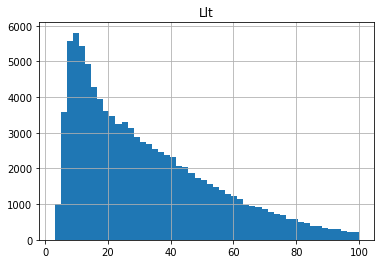

In [3]:
csv = pandas.read_csv(filename)
csv = csv.dropna(axis=0).reset_index(drop=True)#drop NaN

csv = csv[csv['Lmt']>0.1].reset_index(drop=True)
csv = csv[csv['Lmr']>0.1].reset_index(drop=True)
csv = csv[csv['k']>0].reset_index(drop=True)


#N1s = np.zeros(len(csv))
#N2s = np.zeros(len(csv))
#offset = np.zeros(len(csv))

array_len = len(csv)
"""

array_len = len(csv)

for i in range(0, array_len): 

    csv['I1'][i] = csv['I1'][i].replace('i', 'j')
    csv['I2'][i] = csv['I2'][i].replace('i', 'j')
    csv['I1'][i] = csv['I1'][i].replace(' ', '')
    csv['I2'][i] = csv['I2'][i].replace(' ', '')
    csv['I1'][i] = complex(csv['I1'][i]).real
    csv['I2'][i] = complex(csv['I2'][i]).real

    if csv['Lt'][i] > 100 and csv['Lt'][i]/csv['Lmt'][i] > 0.5:
        csv['Lt'][i] = csv['Lt'][i] * 1e-3
    if csv['Lr'][i] > 100 and csv['Lr'][i]/csv['Lmr'][i] > 0.5:
        csv['Lr'][i] = csv['Lr'][i] * 1e-3
    if csv['Lm'][i] > 100 and csv['Lmt'][i] > 50:
        csv['Lm'][i] = csv['Lm'][i] * 1e-3
    if csv['Lm'][i] > 100:
        csv['Lm'][i] = csv['Lm'][i] * 1e-3

csv['I1'] = pandas.to_numeric(csv['I1'], downcast="float")
csv['I2'] = pandas.to_numeric(csv['I2'], downcast="float")

"""

# extra parameter
N1s = csv["N1"].to_numpy() **2
N2s = csv["N2"].to_numpy() **2
offset = abs(csv["offset_tx"]-csv["offset_rx"])
N1N2 = N1s*N2s
sqrtN1N2 = np.sqrt(N1s*N2s)
sqrtN1N22 = np.sqrt(N1s*N2s)**2
space1_ex = csv["space1"].to_numpy() * csv["w1"].to_numpy()
space3_ex = csv["space3"].to_numpy() * csv["l1"].to_numpy() * 2
space2_ex = csv["space2"].to_numpy() * csv["w1"].to_numpy()
space4_ex = csv["space4"].to_numpy() * csv["l1"].to_numpy() * 2
space2_ex2 = csv["space2"].to_numpy() * csv["w1"].to_numpy() * csv["N1"].to_numpy() **2 * csv["N2"].to_numpy() **2  
space4_ex2 = csv["space4"].to_numpy() * csv["l1"].to_numpy() * 2 * csv["N1"].to_numpy() **2 * csv["N2"].to_numpy() **2  
length1 = csv["N1"].to_numpy() * (csv["l1"]*2 + csv["space1"]*2 + csv["w1"] + csv["space3"]*2)/2 + csv["N1"].to_numpy() * (csv["l1"]*2 + csv["space1"]*2 + csv["space5"] *2 + csv["w1"] + csv["space3"]*2)/2
length2 = csv["N1"].to_numpy() * (csv["l1"]*2 + csv["space2"]*2 + csv["w1"] + csv["space4"]*2)/2 + csv["N1"].to_numpy() * (csv["l2"]*2 + csv["space2"]*2 + csv["space6"] *2 + csv["w1"] + csv["space4"]*2)/2
length3 = csv["N2"].to_numpy() * (csv["l1"]*2 + csv["space1"]*2 + csv["w1"] + csv["space3"]*2)/2 + csv["N2"].to_numpy() * (csv["l1"]*2 + csv["space1"]*2 + csv["space5"] *2 + csv["w1"] + csv["space3"]*2)/2
length4 = csv["N2"].to_numpy() * (csv["l1"]*2 + csv["space2"]*2 + csv["w1"] + csv["space4"]*2)/2 + csv["N2"].to_numpy() * (csv["l2"]*2 + csv["space2"]*2 + csv["space6"] *2 + csv["w1"] + csv["space4"]*2)/2
window1 = (csv["l1"].to_numpy() * 2 + csv["space1"].to_numpy() *2) * (csv["w1"].to_numpy() + csv["space3"].to_numpy() *2)
window2 = (csv["l1"].to_numpy() * 2 + csv["space2"].to_numpy() *2) * (csv["w1"].to_numpy() + csv["space4"].to_numpy() *2)
from_l2 = (csv["l2"]).to_numpy() - (csv["space2"]).to_numpy() - (csv["space5"]).to_numpy()
corevolume = (4*csv["l1"].to_numpy() + 2*csv["l2"].to_numpy()) * csv["h1"].to_numpy() * csv["w1"].to_numpy() - 2 * csv["l2"].to_numpy() * csv["h1"].to_numpy() * csv["w1"].to_numpy()
corearea  = 2*csv["l1"].to_numpy() * csv["w1"].to_numpy()

#csv['sqrtN1N2'] = pandas.to_numeric(csv['sqrtN1N2'], downcast="float")



#N1s = pandas.DataFrame(N1s,columns=["N1s"])
#N2s = pandas.DataFrame(N2s,columns=["N2s"])
offset = pandas.DataFrame(offset,columns=["offset"])
#N1N2 = pandas.DataFrame(N1N2,columns=["N1N2"])
#sqrtN1N2 = pandas.DataFrame(sqrtN1N2,columns=["sqrtN1N2"])
#sqrtN1N22 = pandas.DataFrame(sqrtN1N22,columns=["sqrtN1N22"])
#space1_ex = pandas.DataFrame(space1_ex,columns=["space1_ex"])
#space3_ex = pandas.DataFrame(space3_ex,columns=["space3_ex"])
#space2_ex = pandas.DataFrame(space2_ex,columns=["space2_ex"])
#space4_ex = pandas.DataFrame(space4_ex,columns=["space4_ex"])
#space2_ex2 = pandas.DataFrame(space2_ex2,columns=["space2_ex2"])
#space4_ex2 = pandas.DataFrame(space4_ex2,columns=["space4_ex2"])
length1 = pandas.DataFrame(length1,columns=["length1"])
#length2 = pandas.DataFrame(length2,columns=["length2"])
#length3 = pandas.DataFrame(length3,columns=["length3"])
length4 = pandas.DataFrame(length4,columns=["length4"])
#window1 = pandas.DataFrame(window1,columns=["window1"])
window2 = pandas.DataFrame(window2,columns=["window2"])
from_l2 = pandas.DataFrame(from_l2,columns=["from_l2"])
#corevolume = pandas.DataFrame(corevolume,columns=["corevolume"])
#corearea = pandas.DataFrame(corearea ,columns=["corearea"])
 
csv = pandas.concat([csv,offset,length1,length4,window2,from_l2],axis=1)



R1 = np.zeros(array_len)
R2 = np.zeros(array_len)

for i in range(0, array_len): 
    R1[i] = csv['copperloss_tx'][i]/csv['I1'][i]/csv['I1'][i]
    R2[i] = csv['copperloss_rx'][i]/csv['I2'][i]/csv['I2'][i]

csv = csv.assign(R1 = R1)
csv = csv.assign(R2 = R2)





# N1,N2,d1,d2,freq,move_tx,move_rx,offset_tx,offset_rx,per,space1,space2,space3,space4,space5,space6,l1,l2,h1,w1,Lmt,Lmr,Llt,Llr,k,Lt,Lr,Lm,Rt,Rr,I1,I2,Zt,Zr,Zm,copperloss_tx,copperloss_rx




#csv = csv[csv['copperloss_tx'] < 1000]
#csv = csv[csv['copperloss_rx'] < 1000]

#csv = csv[csv['Lmt'] < 30]
#csv = csv[csv['Lmt'] > 3]
#csv = csv[csv['Lmr'] < 10]
#csv = csv[csv['Lmr'] > 3]
#csv = csv[csv['Llt'] < 100]
#csv = csv[csv['Llt'] > 3]
#csv = csv[csv['Lr'] < 20]
csv = csv[csv['Llt'] < 100]
csv = csv[csv['Llt'] > 3]

# normalize data
#N1,N2,d1,d2,freq,move_tx,move_rx,offset_tx,offset_rx,per,space1,space2,space3,space4,space5,space6,l1, l2, h1, w1, I1, I2 = np.hsplit(csv,22)
#input_arrs = [N1,N2,d1,d2,freq,move_tx,move_rx,offset_tx,offset_rx,per,space1,space2,space3,space4,space5,space6,l1, l2, h1, w1, I1, I2] # 22
#normalized_inp = [ (inp-mean)/std  for i,(inp, mean,std) in enumerate(zip(input_arrs, INPUT_MEANS,INPUT_STDS)) ]


csv["N1"] = (csv["N1"] - csv.describe().iloc[1,:][0])/csv.describe().iloc[2,:][0]
csv["N2"] = (csv["N2"] - csv.describe().iloc[1,:][1])/csv.describe().iloc[2,:][1]
csv["d1"] = (csv["d1"] - csv.describe().iloc[1,:][2])/csv.describe().iloc[2,:][2]
csv["d2"] = (csv["d2"] - csv.describe().iloc[1,:][3])/csv.describe().iloc[2,:][3]
#csv["freq"] = (csv["freq"] - csv.describe().iloc[1,:][5])/csv.describe().iloc[2,:][5]
csv["move_tx"] = (csv["move_tx"] - csv.describe().iloc[1,:][5])/csv.describe().iloc[2,:][5]
csv["move_rx"] = (csv["move_rx"] - csv.describe().iloc[1,:][6])/csv.describe().iloc[2,:][6]
csv["offset_tx"] = (csv["offset_tx"] - csv.describe().iloc[1,:][7])/csv.describe().iloc[2,:][7]
csv["offset_rx"] = (csv["offset_rx"] - csv.describe().iloc[1,:][8])/csv.describe().iloc[2,:][8]
csv["per"] = (csv["per"] - csv.describe().iloc[1,:][9])/csv.describe().iloc[2,:][9]
csv["space1"] = (csv["space1"] - csv.describe().iloc[1,:][10])/csv.describe().iloc[2,:][10]
csv["space2"] = (csv["space2"] - csv.describe().iloc[1,:][11])/csv.describe().iloc[2,:][11]
csv["space3"] = (csv["space3"] - csv.describe().iloc[1,:][12])/csv.describe().iloc[2,:][12]
csv["space4"] = (csv["space4"] - csv.describe().iloc[1,:][13])/csv.describe().iloc[2,:][13]
csv["space5"] = (csv["space5"] - csv.describe().iloc[1,:][14])/csv.describe().iloc[2,:][14]
csv["space6"] = (csv["space6"] - csv.describe().iloc[1,:][15])/csv.describe().iloc[2,:][15]
csv["l1"] = (csv["l1"] - csv.describe().iloc[1,:][16])/csv.describe().iloc[2,:][16]
csv["l2"] = (csv["l2"] - csv.describe().iloc[1,:][17])/csv.describe().iloc[2,:][17]
csv["h1"] = (csv["h1"] - csv.describe().iloc[1,:][18])/csv.describe().iloc[2,:][18]
csv["w1"] = (csv["w1"] - csv.describe().iloc[1,:][19])/csv.describe().iloc[2,:][19]

'''
csv["N1s"] = (csv["N1s"] - csv.describe().iloc[3,:][24])/(csv.describe().iloc[7,:][24]-csv.describe().iloc[3,:][24])
csv["N2s"] = (csv["N2s"] - csv.describe().iloc[3,:][25])/(csv.describe().iloc[7,:][25]-csv.describe().iloc[3,:][25])
csv["offset"] = (csv["offset"] - csv.describe().iloc[1,:][26])/csv.describe().iloc[2,:][26]
#csv["sqrtN1N22"] = (csv["sqrtN1N22"] - csv.describe().iloc[1,:][27])/csv.describe().iloc[2,:][27]
csv["space2_ex"] = (csv["space2_ex"] - csv.describe().iloc[1,:][28])/csv.describe().iloc[2,:][28]
csv["space4_ex"] = (csv["space4_ex"] - csv.describe().iloc[1,:][29])/csv.describe().iloc[2,:][29]
'''

#csv = csv[csv['R2'] < 0.15]
#csv = csv[csv['R2'] > 0.03]
#csv = csv[csv['R2'] < 0.15]

csv = csv.drop('Rt',axis=1)
csv = csv.drop('Rr',axis=1)
csv = csv.drop('Zt',axis=1)
csv = csv.drop('Zr',axis=1)
csv = csv.drop('Zm',axis=1)
csv = csv.drop('Lmt',axis=1)
csv = csv.drop('Lmr',axis=1)
#csv = csv.drop('Llt',axis=1)
csv = csv.drop('Llr',axis=1)
csv = csv.drop('k',axis=1)
csv = csv.drop('Lt',axis=1)
csv = csv.drop('Lr',axis=1)
csv = csv.drop('Lm',axis=1)
csv = csv.drop('copperloss_tx',axis=1)
csv = csv.drop('copperloss_rx',axis=1)
csv = csv.drop('R1',axis=1)
csv = csv.drop('R2',axis=1)

dataset = csv
dataset = dataset.dropna(axis=0).reset_index(drop=True)



dataset.hist('Llt',bins=50)
#dataset.hist('I2',bins=50)

dataset.describe()
dataset



In [4]:
data = dataset.sample(frac=0.9, random_state=786).reset_index(drop=True)
data_unseen = dataset.drop(data.index).reset_index(drop=True)


print('Data for Modeling: ' + str(data.shape))
print('Unseen Data For Predictions: ' + str(data_unseen.shape))

#data.to_csv("./train_data.csv")

Data for Modeling: (87566, 28)
Unseen Data For Predictions: (9730, 28)


In [5]:
from pycaret.regression import *
exp_reg101 = setup(data = dataset, target = 'Llt', session_id=123, silent=True) 

,Description,Value
0,session_id,123
1,Target,Llt
2,Original Data,"(97296, 28)"
3,Missing Values,False
4,Numeric Features,26
5,Categorical Features,1
6,Ordinal Features,False
7,High Cardinality Features,False
8,High Cardinality Method,None
9,Transformed Train Set,"(68107, 27)"


In [6]:
# top3 = [ create_model(name) for name in ["xgboost","lightgbm", "rf"] ]
#top3 = compare_models(n_select = 3) 
#best5 = create_model('lightgbm',num_leaves=60, max_depth=20, min_data_in_leaf=20) # default num_leave : 31 / max_depth = -1 / min_data_in_leaf = 20
#best5 = create_model('mlp')
#best5 = create_model('gbr')
lgbm = create_model('lightgbm',num_leaves=80, max_depth=25, min_data_in_leaf=20) # default num_leave : 31 / max_depth = -1 / min_data_in_leaf = 20
#et = create_model('et')
#rf = create_model('rf')
#top3 = [lgbm, et, rf]

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,1.2591,4.7900,2.1886,0.9901,0.0536,0.0416
1,1.2555,4.4919,2.1194,0.9905,0.0544,0.0413
2,1.2327,4.2949,2.0724,0.9909,0.0543,0.0415
3,1.2648,3.7964,1.9484,0.9921,0.0546,0.0417
4,1.2194,3.7421,1.9344,0.9920,0.0517,0.0409
5,1.2200,3.4999,1.8708,0.9924,0.0534,0.0419
6,1.1924,3.8326,1.9577,0.9918,0.0522,0.0404
7,1.2414,3.7221,1.9293,0.9924,0.0520,0.0413
8,1.2727,4.1250,2.0310,0.9913,0.0541,0.0426
9,1.2331,3.7854,1.9456,0.9921,0.0524,0.0410


In [7]:
#tuned_top3 = [tune_model(i) for i in top3]

In [8]:
#bagged_top3 = [ensemble_model(i) for i in top3]


In [9]:
#tuned_model = tune_model(best5, optimize = 'MSE')

In [10]:
#blender = blend_models(estimator_list = top3)

In [11]:
#stacked = stack_models(estimator_list=top3)

In [12]:
#automl = automl(optimize = 'RMSE')

In [13]:
lgbm

LGBMRegressor(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
              importance_type='split', learning_rate=0.1, max_depth=25,
              min_child_samples=20, min_child_weight=0.001, min_data_in_leaf=20,
              min_split_gain=0.0, n_estimators=100, n_jobs=-1, num_leaves=80,
              objective=None, random_state=123, reg_alpha=0.0, reg_lambda=0.0,
              silent=True, subsample=1.0, subsample_for_bin=200000,
              subsample_freq=0)

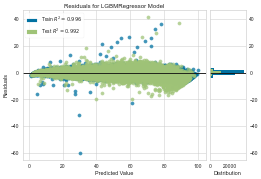

In [28]:
plota = plot_model(estimator = lgbm, plot='residuals',scale=0.5)

In [27]:
help(plot_model)

Help on function plot_model in module pycaret.regression:

plot_model(estimator, plot: str = 'residuals', scale: float = 1, save: bool = False, fold: Union[int, Any, NoneType] = None, fit_kwargs: Union[dict, NoneType] = None, groups: Union[str, Any, NoneType] = None, use_train_data: bool = False, verbose: bool = True, display_format: Union[str, NoneType] = None) -> str
    This function analyzes the performance of a trained model on holdout set. 
    It may require re-training the model in certain cases.
    
    
    Example
    --------
    >>> from pycaret.datasets import get_data
    >>> boston = get_data('boston')
    >>> from pycaret.regression import *
    >>> exp_name = setup(data = boston,  target = 'medv')
    >>> lr = create_model('lr')
    >>> plot_model(lr, plot = 'residual')
    
    
    estimator: scikit-learn compatible object
        Trained model object
    
    
    plot: str, default = 'residual'
        List of available plots (ID - Name):
    
        * 'residual

In [26]:
dir(plota)

['__bool__',
 '__class__',
 '__delattr__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__']

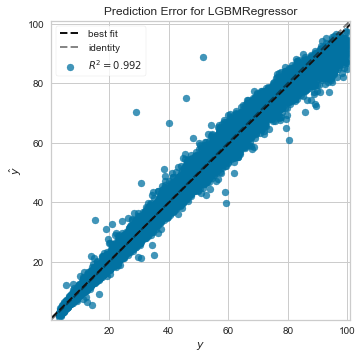

In [15]:
plot_model(estimator = lgbm, plot='error')

In [16]:
evaluate_model(automl)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

In [17]:
lgbm

LGBMRegressor(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
              importance_type='split', learning_rate=0.1, max_depth=25,
              min_child_samples=20, min_child_weight=0.001, min_data_in_leaf=20,
              min_split_gain=0.0, n_estimators=100, n_jobs=-1, num_leaves=80,
              objective=None, random_state=123, reg_alpha=0.0, reg_lambda=0.0,
              silent=True, subsample=1.0, subsample_for_bin=200000,
              subsample_freq=0)

In [18]:
#plot_model(estimator = best5, plot='rfe')

In [19]:
plot_model(estimator = best5, plot = 'feature_all')

NameError: name 'best5' is not defined

In [ ]:
evaluate_model(best5)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

In [ ]:
save_model(lgbm, "ML_model2_v3_2021_08_13_v1_Llt")

Transformation Pipeline and Model Successfully Saved


(Pipeline(memory=None,
          steps=[('dtypes',
                  DataTypes_Auto_infer(categorical_features=[],
                                       display_types=False, features_todrop=[],
                                       id_columns=[], ml_usecase='regression',
                                       numerical_features=[], target='Llt',
                                       time_features=[])),
                 ('imputer',
                  Simple_Imputer(categorical_strategy='not_available',
                                 fill_value_categorical=None,
                                 fill_value_numerical=None,
                                 numeric_strategy='m...
                  LGBMRegressor(boosting_type='gbdt', class_weight=None,
                                colsample_bytree=1.0, importance_type='split',
                                learning_rate=0.1, max_depth=25,
                                min_child_samples=20, min_child_weight=0.001,
                  